Projet PPD, Binome:
  - Wacim BELAHCEL
  - Imad Oualid KACIMI

  
Sujet: Analyse de sentiment Yelp

## **package installation**

In [ ]:
pip install folium

In [ ]:
!pip install num2words

     |████████████████████████████████| 102kB 4.0MB/s 


In [ ]:
!pip install unrar

In [ ]:
!pip install flashtext

  Created wheel for flashtext: filename=flashtext-2.7-py2.py3-none-any.whl size=9299 sha256=1e0d95ab1579c933ba7a53dac0764aa18289c6887d7d5584d5f09b06d5ade921
  Stored in directory: /root/.cache/pip/wheels/37/db/d7/fe74f7cb8e5c3afed90fe6f4967c933a6f13d81ab6b3d3128c
Successfully built flashtext


In [ ]:
!pip install swifter

     |████████████████████████████████| 634kB 11.3MB/s 
     |████████████████████████████████| 296kB 23.8MB/s 
     |████████████████████████████████| 583kB 25.4MB/s 
     |████████████████████████████████| 112kB 32.5MB/s 
     |████████████████████████████████| 48.5MB 90kB/s 
     |████████████████████████████████| 17.2MB 253kB/s 
     |████████████████████████████████| 81kB 5.9MB/s 
     |████████████████████████████████| 71kB 5.6MB/s 
     |████████████████████████████████| 81kB 5.0MB/s 
     |████████████████████████████████| 1.3MB 50.7MB/s 
     |████████████████████████████████| 133kB 44.8MB/s 
     |████████████████████████████████| 204kB 47.7MB/s 
     |████████████████████████████████| 3.1MB 37.2MB/s 
     |████████████████████████████████| 92kB 5.5MB/s 
     |████████████████████████████████| 143kB 63.6MB/s 
     |████████████████████████████████| 296kB 34.5MB/s 
  Created wheel for swifter: filename=swifter-1.0.7-cp37-none-any.whl size=13980 sha256=32ee263d0d26618f8540fca0a

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## **Import**

In [ ]:
import nltk
from nltk import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import LancasterStemmer, WordNetLemmatizer
import pandas as pd
import re

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string 
import json
from bs4 import BeautifulSoup
import unicodedata
from csv import writer
from flashtext import KeywordProcessor
import nltk
import numpy as np
from nltk.corpus import wordnet
import swifter
nltk.download('stopwords') 
nltk.download('punkt')
set(stopwords.words('english'))
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('omw')



[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package omw to /root/nltk_data...
[nltk_data]   Unzipping corpora/omw.zip.


True

In [ ]:
import folium
import pandas as pd
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster
import nltk
nltk.download('wordnet')
nltk.download('stopwords')
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer 
import numpy as np
import spacy
import matplotlib.pyplot as plt

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:

pd.set_option("display.max_rows", None, "display.max_columns", None)
#pd.set_option('display.max_colwidth', None)

## **Reading data and restaurant filtering**

In [ ]:
df_business = pd.read_json("/content/drive/MyDrive/yelp/yelp_academic_dataset_business.json", lines=True)

In [ ]:
df_business.columns

Index(['business_id', 'name', 'address', 'city', 'state', 'postal_code',
       'latitude', 'longitude', 'stars', 'review_count', 'is_open',
       'attributes', 'categories', 'hours'],
      dtype='object')

In [ ]:
df_business.dropna(subset=["categories"], inplace=True)

In [ ]:
df_business.state.unique()

array(['CO', 'OR', 'FL', 'GA', 'BC', 'OH', 'TX', 'MA', 'WA', 'KS', 'CA',
       'NM', 'NC', 'OK', 'IL', 'NY', 'AZ', 'ON', 'NH', 'DE', 'MN', 'VA',
       'WI', 'WY', 'KY', 'MI', 'DC', 'ME', 'ABE', 'AL', 'HI'],
      dtype=object)

In [ ]:
df_business = df_business[df_business["categories"].str.contains("Restaurants")]

In [ ]:
df_business.city.unique()

array(['boulder', 'portland', 'vancouver', 'columbus', 'peabody',
       'orlando', 'pine castle', 'boston', 'burnaby', 'austin',
       'clermont', 'surrey', 'sanford', 'burlington', 'atlanta',
       'somerville', 'swampscott', 'deltona', 'buda', 'coquitlam',
       'cambridge', 'apopka', 'titusville', 'roslindale', 'winter park',
       'newton', 'altamonte springs', 'urbancrest', 'tucker',
       'stone mountain', 'hingham', 'tigard', 'saugus', 'braintree',
       'danvers', 'oviedo', 'quincy', 'melrose', 'watertown', 'kissimmee',
       'clackamas', 'kyle', 'richmond', 'stoughton', 'charlestown',
       'forest park', 'north vancouver', 'beaverton', 'sudbury', 'london',
       'needham', 'milwaukie', 'cocoa', 'west roxbury', 'decatur',
       'lake buena vista', 'salem', 'jackson', 'lake mary', 'randolph',
       'poinciana', 'weymouth', 'framingham', 'beverly', 'bee cave',
       'allston', 'dorchester center', 'grove city', 'woburn',
       'nantasket beach', 'powell', 'winchest

In [ ]:
df_business.duplicated(subset=['business_id'])

0         False
1         False
5         False
7         False
12        False
          ...  
160573    False
160574    False
160575    False
160583    False
160584    False
Length: 50763, dtype: bool

In [ ]:
df_business.drop_duplicates(subset=['business_id'])

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,6iYb2HFDywm3zjuRg0shjw,Oskar Blues Taproom,921 Pearl St,Boulder,CO,80302,40.017544,-105.283348,4.0,86,1,"{'RestaurantsTableService': 'True', 'WiFi': 'u...","Gastropubs, Food, Beer Gardens, Restaurants, B...","{'Monday': '11:0-23:0', 'Tuesday': '11:0-23:0'..."
1,tCbdrRPZA0oiIYSmHG3J0w,Flying Elephants at PDX,7000 NE Airport Way,Portland,OR,97218,45.588906,-122.593331,4.0,126,1,"{'RestaurantsTakeOut': 'True', 'RestaurantsAtt...","Salad, Soup, Sandwiches, Delis, Restaurants, C...","{'Monday': '5:0-18:0', 'Tuesday': '5:0-17:0', ..."
5,D4JtQNTI4X3KcbzacDJsMw,Bob Likes Thai Food,3755 Main St,Vancouver,BC,V5V,49.251342,-123.101333,3.5,169,1,"{'GoodForKids': 'True', 'Alcohol': 'u'none'', ...","Restaurants, Thai","{'Monday': '17:0-21:0', 'Tuesday': '17:0-21:0'..."
7,jFYIsSb7r1QeESVUnXPHBw,Boxwood Biscuit,740 S High St,Columbus,OH,43206,39.947007,-82.997471,4.5,11,1,None,"Breakfast & Brunch, Restaurants","{'Saturday': '8:0-14:0', 'Sunday': '8:0-14:0'}"
12,HPA_qyMEddpAEtFof02ixg,Mr G's Pizza & Subs,474 Lowell St,Peabody,MA,01960,42.541155,-70.973438,4.0,39,1,"{'RestaurantsGoodForGroups': 'True', 'HasTV': ...","Food, Pizza, Restaurants","{'Monday': '11:0-21:0', 'Tuesday': '11:0-21:0'..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
160573,Zl6SUy6x9jqjRu2HbtEO6A,Split Dine and Drink,7335 SW Bridgeport Rd,Tigard,OR,97224,45.394457,-122.752535,2.0,48,0,"{'RestaurantsDelivery': 'False', 'GoodForKids'...","American (Traditional), Desserts, American (Ne...","{'Monday': '11:0-23:0', 'Tuesday': '11:0-23:0'..."
160574,Q78fYV6B6P6GmX07YVgi4g,Maudie’s Hill Country,12506 Shops Pkwy,Bee Cave,TX,78738,30.304761,-97.937394,3.0,310,1,"{'BusinessParking': '{'garage': False, 'street...","Mexican, Bars, Nightlife, Tex-Mex, Restaurants","{'Monday': '0:0-0:0', 'Tuesday': '9:0-21:0', '..."
160575,uXdQkuEtvLAzfc3MsO-sTQ,Mama's Cocina Latina,1958 Piedmont Rd NE,Atlanta,GA,30324,33.810996,-84.367084,3.0,185,1,"{'WiFi': 'u'no'', 'BusinessAcceptsCreditCards'...","Restaurants, Mexican, Latin American","{'Monday': '0:0-0:0', 'Tuesday': '0:0-0:0', 'W..."
160583,GB75wPibj3IjNauaoCxyGA,Havana Cafe,910 NW 14th St,Portland,OR,97209,45.529647,-122.685153,4.0,10,1,"{'RestaurantsTakeOut': 'True', 'RestaurantsDel...","Cuban, Sandwiches, Restaurants, Cafes",None


In [ ]:
df_business["city"] = df_business["city"].str.lower()

In [ ]:
df_business.groupby("city").count().sort_values(by="business_id", ascending=False)

,business_id,name,address,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
city,,,,,,,,,,,,,
portland,5734,5734,5734,5734,5734,5734,5734,5734,5734,5734,5689,5734,4902
vancouver,5026,5026,5026,5026,5026,5026,5026,5026,5026,5026,4963,5026,4205
austin,4960,4960,4960,4960,4960,4960,4960,4960,4960,4960,4914,4960,4246
atlanta,4181,4181,4181,4181,4181,4181,4181,4181,4181,4181,4151,4181,3496
orlando,3762,3762,3762,3762,3762,3762,3762,3762,3762,3762,3736,3762,3243
boston,2846,2846,2846,2846,2846,2846,2846,2846,2846,2846,2830,2846,2303
columbus,2632,2632,2632,2632,2632,2632,2632,2632,2632,2632,2613,2632,2262
richmond,903,903,903,903,903,903,903,903,903,903,892,903,700
cambridge,775,775,775,775,775,775,775,775,775,775,769,775,665


In [ ]:
df_business = df_business[df_business["city"]=="richmond"]

In [ ]:
restaurant_array = df_business["business_id"].values.tolist()
#np.in1d(values, data)

## **function for text cleaning**

In [ ]:



regex_numbers = re.compile(r'\b[a-zA-Z]*\d+[a-zA-Z]*\b')
regex_urls = re.compile(r'\b(([\w-]+://?|www[.])[^\s()<>]+(?:([\w\d]+)|([^[:punct:]\s]|/)))\b')
translator = str.maketrans(string.punctuation, ' '*len(string.punctuation))

def remove_urls(s):
    return regex_urls.sub(' ',s)

def remove_numbers(s):
    return regex_numbers.sub(' ',s)

def noAsciiRemoval(sentence):
    """
    Remove no ASCII character.
    :param sentence: Input sentence.
    :return: ASCII sentence
    """
    return unicodedata.normalize('NFKD', sentence).encode('ascii', 'ignore').decode('utf-8', 'ignore')


def properNounsRemoval(sentence):

    tagged_sentence = nltk.tag.pos_tag(sentence.split())
    edited_sentence = [word for word,tag in tagged_sentence if tag != 'NNP' and tag != 'NNPS']
    return " ".join(edited_sentence)

def deletePonc(text):
    return text.translate(translator)


def toLower(text):
    return text.lower()

def numericToWord(text):
    text =  re.sub(r"(\d+)", lambda x: num2words.num2words(int(x.group(0))), text)
    return text

def RemoveStopWords(text):  
    stop_words = set(stopwords.words('english'))   
    word_tokens = word_tokenize(text)  
    filtered_sentence = [w for w in word_tokens if not w in stop_words]   
    filtered_sentence = []   
    for w in word_tokens: 
        if w not in stop_words: 
            filtered_sentence.append(w) 
    
    return " ".join(filtered_sentence)




def normalize_aggressively(words):

    words = remove_urls(words)
    words = lemmatize_sentence(words)
    words = properNounsRemoval(words)
    words = noAsciiRemoval(words)
    words = toLower(words)
    words = deletePonc(words)
    words = remove_numbers(words)
    words = RemoveStopWords(words)
    
    return words

def normalize_bert(words):

    words = remove_urls(words)
    words = noAsciiRemoval(words)
    words = remove_numbers(words)
    
    return words

def clean_data_aggressively(text):
  
    if isinstance(text, str):
      result = normalize_aggressively(text)
      return result
    
    return None

def clean_data_bert(text):
  
    if isinstance(text, str):
      result = normalize_bert(text)
      return result
    
    return None



In [ ]:
clean_data("I've stayed at many Marriott and Renaissance Marriott's and this was a huge disappointment! The front desk and atrium is nice..there is a starbucks on site which is nice.\n\nThe rooms are run down and old. There is a flat screen but that is to be expected of a Renaissance.\n\nWe got this hotel via Priceline at a rate of $75/night...good deal for the price but this is not a true Renaissance.")

'stay many huge disappointment front desk atrium nice starbucks site nice room run old flat screen expect get hotel via rate night good deal price true'

In [ ]:


lemmatizer = WordNetLemmatizer()

def  adverb_to_adj(word):
  for ss in wordnet.synsets(word):
    for lemmas in ss.lemmas(): # all possible lemmas
        for ps in lemmas.pertainyms(): # all possible pertainyms
            return ps.name()
  return None

# function to convert nltk tag to wordnet tag
def nltk_tag_to_wordnet_tag(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return wordnet.VERB
    elif nltk_tag.startswith('N'):
        return wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return wordnet.ADV
    else:          
        return None

def lemmatize_sentence(sentence):
    #tokenize the sentence and find the POS tag for each token
    nltk_tagged = nltk.pos_tag(nltk.word_tokenize(sentence))  
    #tuple of (token, wordnet_tag)
    wordnet_tagged = map(lambda x: (x[0], nltk_tag_to_wordnet_tag(x[1])), nltk_tagged)
    lemmatized_sentence = []
    for word, tag in wordnet_tagged:
        if tag is None:
            #if there is no available tag, append the token as is
            lemmatized_sentence.append(word)
        elif tag == wordnet.ADV:
          result = adverb_to_adj(word)
          if result:
            lemmatized_sentence.append(result)
          else:
            lemmatized_sentence.append(word)
        else:        
            #else use the tag to lemmatize the token
            lemmatized_sentence.append(lemmatizer.lemmatize(word, tag))
    return " ".join(lemmatized_sentence)

print(lemmatizer.lemmatize("I am loving it")) #I am loving it
print(lemmatizer.lemmatize("loving")) #loving
print(lemmatizer.lemmatize("loving", "v")) #love
print(lemmatize_sentence("I am loving it")) #I be love it

I am loving it
loving
love
I be love it


In [ ]:
keyword_processor = KeywordProcessor(case_sensitive=True)
keyword_processor.add_keywords_from_list(restaurant_array)

## **Getting the reviews for richmond**

In [ ]:


fp = open('/content/drive/MyDrive/yelp/yelp_academic_dataset_review.json', 'r')
out_file = open("/content/drive/MyDrive/yelp/rest_data_yelp2.csv", 'a+', newline='')

csv_writer = writer(out_file)
line = fp.readline()
data_size = 0
omited = 0

while line:
    try:
        temp = fp.readline()
        line = temp
        review = json.loads(line)
        if not keyword_processor.extract_keywords(review["business_id"]):
          continue

        text = review["text"]
        if not text:
            continue

        label = int(review["stars"] - 1)
        tocsv = []
        
        tocsv.append(review["business_id"])
        tocsv.append(label)
        tocsv.append(text)
        csv_writer.writerow(tocsv)
        data_size += 1
        
        if data_size%5000 == 0:
            print("Cleaning at ", data_size)
            
            
    except:
        omited += 1
out_file.close()

Cleaning at  5000
Cleaning at  10000
Cleaning at  15000
Cleaning at  20000
Cleaning at  25000
Cleaning at  30000
Cleaning at  35000
Cleaning at  40000


## **aggresive data cleaning for lstm, log reg and lstm**

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/yelp/rest_data_yelp2.csv", names=["business_is","label","text"])

In [ ]:
df.iloc[0:10,:]

,label,text
0,1,I've stayed at many Marriott and Renaissance Marriott's and this was a huge disappointment! The front desk and atrium is nice..there is a starbucks on site which is nice.\n\nThe rooms are run down and old. There is a flat screen but that is to be expected of a Renaissance.\n\nWe got this hotel via Priceline at a rate of $75/night...good deal for the price but this is not a true Renaissance.
1,3,"The food is always great here. The service from both the manager as well as the staff is super. Only draw back of this restaurant is it's super loud. If you can, snag a patio table!"
2,0,"This place used to be a cool, chill place. Now its a bunch of neanderthal bouncers hopped up on steroids acting like the can do whatever they want. There are so many better places in davis square where they are glad you are visiting their business. Sad that the burren is now the worst place in davis."
3,1,"The setting is perfectly adequate, and the food comes close. The dining chains like Chilis and Victoria Station do barbecue better.\n\nIt's no surprise you can always pick up coupons for Linwood at restaurant.com."
4,4,"Probably one of the better breakfast sandwiches I've ever had. I had the EGGMEATMUFFIN, the bread was toasted perfectly and the bacon was a real thick cut. Not that lame bacon we are more familiar with at your conventional breakfast diner. In addition, the place was clean and the staff was very helpful. The butcher had several different cuts available and was knowledgable as well as friendly. I left with some cuts of pork and beef and am excited to come back!"
5,4,"I work in the Pru and this is the most affordable and tasty place in the food court. deals where a meal is $5-$7 and the chicken pesto is really good. I am not a chowda person but all there soups I have had are pretty damn good. Broccoli chicken is my favorite. Also, probably the most personable Food court staff I have ever had the pleasure of ordering from."
6,0,"They NEVER seem to get our \norder correct, service is crappy, food is inconsistent and has gone down hill steadily in the last 6-9 months! WILL NEVER GO THERE AGAIN!"
7,3,"I have been here twice and have had really good food and service both times. I got a burger with caramelized onions, a red wine sauce and I believe blue cheese the first time. It was excellent and just the right size for me. I hate going out and ordering a burger that is bigger than my head that I can't even finish half of! Flip's burgers are about the same size I would make for myself at home.\n\nThe second time I went I had a limited time seasonal offering which was a venison burger with pea shoots, some kind of cheese that reminded me of brie, and a very sweet syrupy sauce which I could have done without, but overall it was very good. I also had onion rings and they were possibly the best onion rings I've had ever.\n\nThe only thing I don't really like about Flip is the atmosphere and layout of the tables. I guess they were going for trendy upscale or whatever, but it makes me feel as if I am in a school cafeteria back in high school. I don't like it. There are long white tables shoved up against each other with uncomfortable modern looking plastic chairs that kind of look like they came from Ikea. It's also pretty loud in there because there is nothing to absorb the sound, like a school cafeteria.\n\nThe last time I was in there there were a couple of women with small children. I have no idea why someone would bring a child to Flip unless that child was a very adventerous eater. They don't make anything plain. Everything on the menu has some pretty exotic ingredients. It's also very pricy for burgers. This is the last place on Earth I would bring kids to eat. Burger King is right down the street."
8,4,"This is a five-star restaurant if ever I have seen one! Maurice, one of the owners, met us at the front door, Daniel a seasoned waiter from Hawaii, took care of us and the food was over-the-top delicious. This is not just a r

In [ ]:
df.columns

Index(['label', 'text'], dtype='object')

In [ ]:
df["cleaned_text"] = df["text"].swifter.progress_bar(True).apply(clean_data_aggressively)

In [ ]:
df.to_csv("/content/drive/MyDrive/yelp/cleand_data_yelp.csv", index=False)

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/yelp/cleand_data_yelp.csv")

In [ ]:
df.loc[0,"text"]

"We stopped by here on a Saturday night, and the place was full (small restaurant). Luckily, we made reservations and were seated right away. The place doesn't look like much from the outside (off the main No. 3 road area of Richmond), but the inside is nicely decorated. We ordered:\n\nSalmon tartar ($9): this came in a martini glass with nori wrappers on the side. I liked the combination of the chopped salmon, salmon roe, avocado and mango in a soy dressing.\n\nBlack cod miso ($14): this was really good, not too overpowered by the miso, but the slice of black cod was pretty small. However, I would order it again since it tasted good.\n\nSushi set ($20): this came with a California roll and various pieces of sushi. They use real crab in the roll, and it tasted pretty good.\n\nAssorted tempura dinner set $14): the tempura was nice and lightly fried. The dinner set came with miso soup, rice, sunonomo, and spinach.\n\nWe were getting full by this point, so we didn't order the famed crème 

In [ ]:
df.loc[0,"cleaned_text"]

'stop night place full small restaurant fortunate make reservation seat proper away place n look like much outside main road area inside nice decorate order salmon tartar come martini glass nori wrapper side like combination chopped salmon salmon roe avocado mango soy dressing cod miso true good excessive overpower miso slice black cod reasonable small however would order since taste good set come roll various piece sushi use real crab roll taste reasonable good assorted tempura dinner set tempura nice light fry dinner set come miso soup rice sunonomo spinach get full point n order famed creme brulee make sure save room dessert next time probable best sushi restaurant try area make reservation try'

## **Bert data cleaning**

In [ ]:


fp = open('/content/drive/MyDrive/yelp/yelp_academic_dataset_review.json', 'r')
out_file = open("/content/drive/MyDrive/yelp/rest_setence_embedding.csv", 'a+', newline='')

csv_writer = writer(out_file)
line = fp.readline()
data_size = 0
omited = 0

while line:
    try:
        temp = fp.readline()
        line = temp
        review = json.loads(line)
        if not keyword_processor.extract_keywords(review["business_id"]):
          continue

        text = review["text"]
        if not text:
            continue

        label = int(review["stars"])
        tocsv = []
        
        tocsv.append(review["business_id"])
        tocsv.append(label)
        tocsv.append(text)
        csv_writer.writerow(tocsv)
        data_size += 1
        
        if data_size%5000 == 0:
            print("Cleaning at ", data_size)
            
            
    except:
        omited += 1
out_file.close()

Cleaning at  5000
Cleaning at  10000
Cleaning at  15000
Cleaning at  20000
Cleaning at  25000
Cleaning at  30000
Cleaning at  35000
Cleaning at  40000


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/yelp/rest_setence_embedding.csv", names=["business_id","label","text"])

In [ ]:
df["cleaned_text"] = df["text"].swifter.progress_bar(True).apply(clean_data_bert)

In [ ]:

# The value at the 0-index is mapped to 'A', the value at the 2-index is mapped to 'B'
df.loc[df["label"]<3,"label"]=0
df.loc[df["label"]>3,"label"]=1
df = df[df["label"]!=3]
df

,business_id,label,text,cleaned_text
0,uo8kklLY1LK9mh11BPwywQ,1,"We stopped by here on a Saturday night, and th...","We stopped by here on a Saturday night, and th..."
1,lYy9T8B4al08kHXSDuUZjQ,1,My favourite lunch place in the area. Big port...,My favourite lunch place in the area. Big port...
2,AJOiPJPEei53qh94tG3jFw,0,My girlfriends and I didn't go back to this re...,My girlfriends and I didn't go back to this re...
3,VGq9wu_ZtvonP1Rke4CxYw,1,Really good XLB - delicate yet structurally in...,Really good XLB - delicate yet structurally in...
4,Nk5Hsw1SlRF6I1HcY5EGdA,1,I have been coming here for years. the waffle...,I have been coming here for years. the waffle...
5,sNDfYZP9OYypywbi33aSxw,0,The food tasted good. The waitress who took th...,The food tasted good. The waitress who took th...
6,9yZpfG9uP0DjDHSUQokfvw,1,Kongee Dinesty has one of the best congee (ric...,Kongee Dinesty has one of the best congee (ric...
9,s8GuNWKlwunSdDnz84iyPw,0,Chicken was raw.\nBrisket was dry and tough.\n...,Chicken was raw.\nBrisket was dry and tough.\n...
11,9yZpfG9uP0DjDHSUQokfvw,1,Came here for some Chinese breakfast because i...,Came here for some Chinese breakfast because i...
12,AJOiPJPEei53qh94tG3jFw,0,There is a 20% discount if you put down your o...,There is a % discount if you put down your or...


In [ ]:
df.to_csv("/content/drive/MyDrive/yelp/cleaned_setence_embedding.csv", index=False)


# **Data Visualization**

## **Map visualisation**

In [ ]:
data_cleaned = pd.read_csv("/content/drive/MyDrive/yelp/cleand_data_yelp.csv")
df_business = pd.read_json("/content/drive/MyDrive/yelp/yelp_academic_dataset_business.json", lines=True)

In [ ]:
data_cleaned["label"]= data_cleaned["label"] + 1 

In [ ]:
data_cleaned.head()

,business_is,label,text,cleaned_text
0,uo8kklLY1LK9mh11BPwywQ,4,"We stopped by here on a Saturday night, and th...",stop night place full small restaurant fortuna...
1,lYy9T8B4al08kHXSDuUZjQ,5,My favourite lunch place in the area. Big port...,favourite lunch place area big portion good pr...
2,AJOiPJPEei53qh94tG3jFw,2,My girlfriends and I didn't go back to this re...,girlfriend n go back restaurant renovate find ...
3,VGq9wu_ZtvonP1Rke4CxYw,4,Really good XLB - delicate yet structurally in...,true good delicate yet structural intact rich ...
4,Nk5Hsw1SlRF6I1HcY5EGdA,5,I have been coming here for years. the waffle...,come year waffle awesome quality year year own...


In [ ]:
df_business.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,6iYb2HFDywm3zjuRg0shjw,Oskar Blues Taproom,921 Pearl St,Boulder,CO,80302,40.017544,-105.283348,4.0,86,1,"{'RestaurantsTableService': 'True', 'WiFi': 'u...","Gastropubs, Food, Beer Gardens, Restaurants, B...","{'Monday': '11:0-23:0', 'Tuesday': '11:0-23:0'..."
1,tCbdrRPZA0oiIYSmHG3J0w,Flying Elephants at PDX,7000 NE Airport Way,Portland,OR,97218,45.588906,-122.593331,4.0,126,1,"{'RestaurantsTakeOut': 'True', 'RestaurantsAtt...","Salad, Soup, Sandwiches, Delis, Restaurants, C...","{'Monday': '5:0-18:0', 'Tuesday': '5:0-17:0', ..."
2,bvN78flM8NLprQ1a1y5dRg,The Reclaimory,4720 Hawthorne Ave,Portland,OR,97214,45.511907,-122.613693,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Antiques, Fashion, Used, Vintage & Consignment...","{'Thursday': '11:0-18:0', 'Friday': '11:0-18:0..."
3,oaepsyvc0J17qwi8cfrOWg,Great Clips,2566 Enterprise Rd,Orange City,FL,32763,28.914482,-81.295979,3.0,8,1,"{'RestaurantsPriceRange2': '1', 'BusinessAccep...","Beauty & Spas, Hair Salons",None
4,PE9uqAjdw0E4-8mjGl3wVA,Crossfit Terminus,1046 Memorial Dr SE,Atlanta,GA,30316,33.747027,-84.353424,4.0,14,1,"{'GoodForKids': 'False', 'BusinessParking': '{...","Gyms, Active Life, Interval Training Gyms, Fit...","{'Monday': '16:0-19:0', 'Tuesday': '16:0-19:0'..."


In [ ]:
business_id_mean = data_cleaned.groupby("business_is").mean("label").reset_index()
business_id_mean.rename(columns={"business_is":"business_id"}, inplace=True)
business_id_mean

,business_id,label
0,-7yf2-ax6xpxCXPpHHfNLA,3.555556
1,-De788cROwJH5Kml_SZI1Q,2.400000
2,-Dlf92nQSnQC_vHe4ys0rw,2.583333
3,-RcVqtLDw3QwHbB_7Gw0MQ,3.347368
4,-SoksEQ3fQQ4xcI6knk0Xg,3.095238
...,...,...
898,zQHIwGi1msmYaYFLMbb-0g,3.785714
899,zSW8kufKf4qWzS32nW7Vbg,2.615385
900,zfN4i23ib69G1XtpVAu63g,3.021277
901,zn7GZ4Z0q3GYh2z1gdYGQQ,3.047619


In [ ]:
business_id_mean = business_id_mean.merge(df_business[["business_id", "latitude", "longitude","name", "address"]], how='left', on='business_id') 

In [ ]:
longs = business_id_mean["longitude"].tolist()
lats = business_id_mean["latitude"].tolist()
# calculating mean longitude and latitude values
import statistics
import math
meanLong = statistics.mean(longs)
meanLat = statistics.mean(lats)

In [ ]:
m_3 = folium.Map(location=[meanLat, meanLong], tiles='openstreetmap', zoom_start=13)

# Add points to the map
mc = MarkerCluster()
for idx, row in business_id_mean.iterrows():

    if row["label"] <= 2 : 
      icon=folium.Icon(color="darkred",icon="fa-circle", prefix='fa')

    elif abs(row["label"]) <=3 :
      icon=folium.Icon(color="red",icon="fa-circle", prefix='fa')
    
    elif abs(row["label"]) <= 4 :
      icon=folium.Icon(color="orange",icon="fa-circle", prefix='fa')

    else:
      icon=folium.Icon(color="green",icon="fa-circle", prefix='fa')
      
    
    
    if not math.isnan(row['longitude']) and not math.isnan(row['latitude']):
        mc.add_child(Marker([row['latitude'],row['longitude']], icon=icon,
                            popup="<b>name {}</b>\n <b>address: {}</b>\n<b>rating: {}  ".format(row["name"],row["address"],row["label"]),   ))
m_3.add_child(mc)

# Display the map
m_3


## **data visualization umap, tsne, dbscan**

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/yelp/cleaned_setence_embedding.csv")

In [ ]:
df

,business_id,label,text,cleaned_text
0,uo8kklLY1LK9mh11BPwywQ,1,"We stopped by here on a Saturday night, and th...","We stopped by here on a Saturday night, and th..."
1,lYy9T8B4al08kHXSDuUZjQ,1,My favourite lunch place in the area. Big port...,My favourite lunch place in the area. Big port...
2,AJOiPJPEei53qh94tG3jFw,0,My girlfriends and I didn't go back to this re...,My girlfriends and I didn't go back to this re...
3,VGq9wu_ZtvonP1Rke4CxYw,1,Really good XLB - delicate yet structurally in...,Really good XLB - delicate yet structurally in...
4,Nk5Hsw1SlRF6I1HcY5EGdA,1,I have been coming here for years. the waffle...,I have been coming here for years. the waffle...
5,sNDfYZP9OYypywbi33aSxw,0,The food tasted good. The waitress who took th...,The food tasted good. The waitress who took th...
6,9yZpfG9uP0DjDHSUQokfvw,1,Kongee Dinesty has one of the best congee (ric...,Kongee Dinesty has one of the best congee (ric...
7,s8GuNWKlwunSdDnz84iyPw,0,Chicken was raw.\nBrisket was dry and tough.\n...,Chicken was raw.\nBrisket was dry and tough.\n...
8,9yZpfG9uP0DjDHSUQokfvw,1,Came here for some Chinese breakfast because i...,Came here for some Chinese breakfast because i...
9,AJOiPJPEei53qh94tG3jFw,0,There is a 20% discount if you put down your o...,There is a % discount if you put down your or...


### **sentence_embedding**

In [ ]:
!pip install sentence_transformers

     |████████████████████████████████| 81kB 8.6MB/s 
     |████████████████████████████████| 2.1MB 27.7MB/s 
     |████████████████████████████████| 1.2MB 39.2MB/s 
     |████████████████████████████████| 870kB 52.1MB/s 
     |████████████████████████████████| 3.3MB 51.3MB/s 
  Created wheel for sentence-transformers: filename=sentence_transformers-1.0.4-cp37-none-any.whl size=114307 sha256=70eba668267f427ed487d8d3673d957965cf6342dd2606e05523020070595eaf
  Stored in directory: /root/.cache/pip/wheels/26/ea/89/d0d2e013d951b6d23270aa9ca4018b82632ab7cd933c331316
  Created wheel for sacremoses: filename=sacremoses-0.0.44-cp37-none-any.whl size=886084 sha256=8abc86de09e8a8f51c375f3c77fc5130fa11f0817ad3686e077e95fb4dd5bf9e
  Stored in directory: /root/.cache/pip/wheels/3e/fb/c0/13ab4d63d537658f448366744654323077c4d90069b6512f3c
Successfully built sentence-transformers sacremoses


In [ ]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('distilbert-base-nli-mean-tokens')
embeddings = model.encode(df.cleaned_text.values, show_progress_bar=True)

In [ ]:
embeddings

array([[-0.17074549, -0.5562456 ,  0.12208546, ...,  0.33619976,
        -0.2604698 , -0.16238572],
       [ 0.0017252 , -0.26891974,  0.6931989 , ...,  0.99453366,
        -0.16347866, -0.55176175],
       [ 0.1541411 , -0.5062112 ,  0.3322569 , ...,  0.01478095,
         0.35804456,  0.00974261],
       ...,
       [-0.5322677 , -0.33463728,  0.60525405, ..., -0.12136469,
        -0.16545488,  0.2046911 ],
       [ 0.21810566, -0.42301798,  0.50886804, ...,  0.37693983,
        -0.09206718, -1.2445365 ],
       [-0.1588214 , -0.27631605,  0.9309762 , ...,  0.3725928 ,
        -0.07004193, -0.17835647]], dtype=float32)

In [ ]:
!pip install umap-learn

     |████████████████████████████████| 81kB 8.0MB/s 
     |████████████████████████████████| 1.2MB 28.6MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.1-cp37-none-any.whl size=76569 sha256=53ac1a35f6597c8e75b93ef6a199cce9f9da3271f4e3f34f4c15f5f51f58dc5c
  Stored in directory: /root/.cache/pip/wheels/ad/df/d5/a3691296ff779f25cd1cf415a3af954b987fb53111e3392cf4
  Created wheel for pynndescent: filename=pynndescent-0.5.2-cp37-none-any.whl size=51351 sha256=f80e791a8471eccd01a804b9e78b80ac4161b0efa18ca1acb5bf8ddfec8aac69
  Stored in directory: /root/.cache/pip/wheels/ba/52/4e/4c28d04d144a28f89e2575fb63628df6e6d49b56c5ddd0c74e
Successfully built umap-learn pynndescent


### **umap**

In [ ]:
import umap

In [ ]:
umap_data = umap.UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)


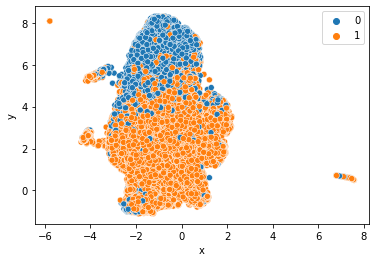

In [ ]:
result = pd.DataFrame(umap_data, columns=['x', 'y'])
sns.scatterplot(result.x, result.y, hue=df["label"].values, legend='full', )

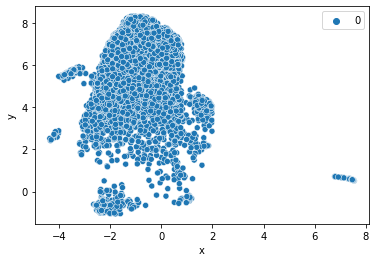

In [ ]:
result["label"] = df["label"]
sub_result_0 = result[result["label"]==0]
sub_result_1 = result[result["label"]==1]
sns.scatterplot(sub_result_0.x, sub_result_0.y, hue=sub_result_0["label"].values, legend='full', )


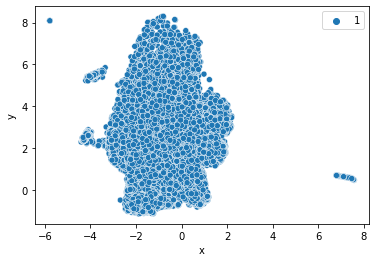

In [ ]:
sns.scatterplot(sub_result_1.x, sub_result_1.y, hue=sub_result_1["label"].values, legend='full', )

###**hdbscan**

In [ ]:
!pip install hdbscan


     |████████████████████████████████| 6.4MB 11.9MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp37-cp37m-linux_x86_64.whl size=2311652 sha256=8f978521b927dc3e9c82f67b0677a00e728543c122ec799bfa51b624bc263ae5
  Stored in directory: /root/.cache/pip/wheels/42/63/fb/314ad6c3b270887a3ecb588b8e5aac50b0fad38ff89bb6dff2
Successfully built hdbscan


In [ ]:
umap_embeddings = umap.UMAP(n_neighbors=15, 
                            n_components=32, 
                            metric='cosine').fit_transform(embeddings)

In [ ]:
import hdbscan
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',
                          cluster_selection_method='eom').fit(umap_embeddings)

In [ ]:
cluster.labels_

array([1, 1, 1, ..., 1, 0, 1])

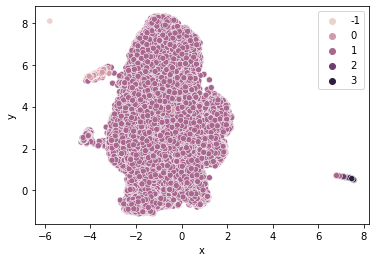

In [ ]:
result_dbscan = pd.DataFrame(umap_data, columns=['x', 'y'])
result_dbscan["label"] = cluster.labels_
sns.scatterplot(result_dbscan.x, result_dbscan.y, hue=result_dbscan["label"].values, legend='full', )

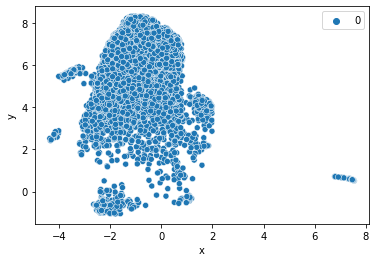

In [ ]:
result_dbscan["label"] = cluster.labels_
sub_result_dbscan_0 = result_dbscan[result_dbscan["label"]==0]
sub_result_dbscan_1 = result_dbscan[result_dbscan["label"]==1]
sns.scatterplot(sub_result_dbscan_0.x, sub_result_dbscan_0.y, hue=sub_result_dbscan_0["label"].values, legend='full', )


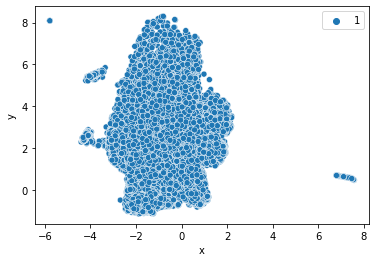

In [ ]:
sns.scatterplot(sub_result_dbscan_1.x, sub_result_dbscan_1.y, hue=sub_result_dbscan_1["label"].values, legend='full', )

### **tsne**

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2,learning_rate=200,perplexity = 30,n_iter=2500,init = 'random',  random_state=123, verbose=2)
X_tsne = tsne.fit_transform(embeddings)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 32342 samples in 4.182s...
[t-SNE] Computed neighbors for 32342 samples in 1868.818s...
[t-SNE] Computed conditional probabilities for sample 1000 / 32342
[t-SNE] Computed conditional probabilities for sample 2000 / 32342
[t-SNE] Computed conditional probabilities for sample 3000 / 32342
[t-SNE] Computed conditional probabilities for sample 4000 / 32342
[t-SNE] Computed conditional probabilities for sample 5000 / 32342
[t-SNE] Computed conditional probabilities for sample 6000 / 32342
[t-SNE] Computed conditional probabilities for sample 7000 / 32342
[t-SNE] Computed conditional probabilities for sample 8000 / 32342
[t-SNE] Computed conditional probabilities for sample 9000 / 32342
[t-SNE] Computed conditional probabilities for sample 10000 / 32342
[t-SNE] Computed conditional probabilities for sample 11000 / 32342
[t-SNE] Computed conditional probabilities for sample 12000 / 32342
[t-SNE] Computed conditional probabilities for 

In [ ]:
X_tsne = tsne.fit_transform(df_text_doc_terme.loc[:, df_text_doc_terme.columns != 'class_lab'].values)

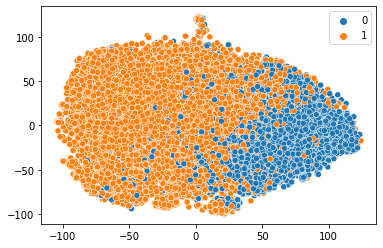

In [ ]:
sns.scatterplot(X_tsne[:,0], X_tsne[:,1], hue=df["label"].values, legend='full')

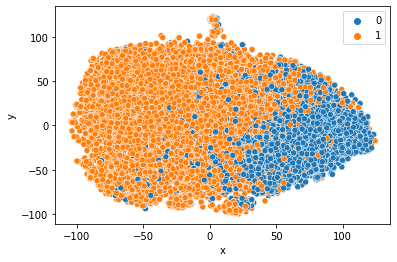

In [ ]:
result_tsne = pd.DataFrame(X_tsne, columns=['x', 'y'])
result_tsne["label"] = df["label"]
sns.scatterplot(result_tsne.x, result_tsne.y, hue=result_tsne["label"].values, legend='full', )

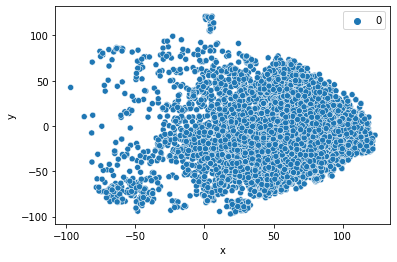

In [ ]:

sub_result_0 = result_tsne[result_tsne["label"]==0]
sub_result_1 = result_tsne[result_tsne["label"]==1]
sns.scatterplot(sub_result_0.x, sub_result_0.y, hue=sub_result_0["label"].values, legend='full', )


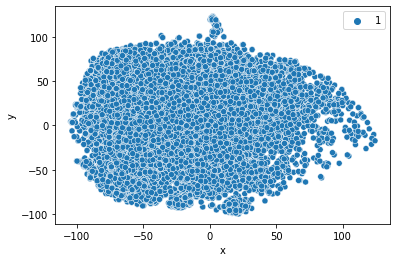

In [ ]:
sns.scatterplot(sub_result_1.x, sub_result_1.y, hue=sub_result_1["label"].values, legend='full', )
